### "Шапка" с названием проекта

В этой ячейке вы найдете оглавление и ключевые этапы работы, которые помогут вам ориентироваться в процессе выполнения проекта. Проект разделен на пять основных этапов, четыре из которых (этапы 2, 3, 4 и 5) вам предлагается выполнить в этом Jupyter Notebook:

- Подготовка среды MLflow - Первый шаг, подготовка и запуск сервисов MLflow, был выполнен вне ноутбука и оформлен в виде shell скрипта. Это основа для работы с экспериментами и логирования результатов ваших моделей.

- Этап 2 - Исследовательский Анализ Данных (EDA): На этом этапе вы проведете тщательный анализ данных, чтобы лучше понять их структуру и особенности.

- Этап 3 - Генерация Признаков и Обучение Модели: После анализа данных вы сгенерируете новые признаки и обучите модель, используя эти признаки.

- Этап 4 - Отбор Признаков и Обучение Модели: На этом шаге вы отберете наиболее значимые признаки и снова обучите модель для улучшения ее качества.

- Этап 5 - Подбор Гиперпараметров и Обучение Финальной Версии Модели: Финальный этап проекта посвящен оптимизации гиперпараметров для достижения максимального качества модели.

Для удобства навигации и организации работы, пожалуйста, следуйте оглавлению и рекомендациям, описанным в каждом этапе.

> ### Важно: Переобучение моделей
> На каждом этапе проекта, где требуется переобучение модели, важно не просто выполнить эту процедуру, но и тщательно проверить качество модели на соответствующих выборках. Это включает в себя анализ метрик качества, визуализацию результатов, сравнение с предыдущими моделями и, при необходимости, корректировку.

In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split,cross_val_score
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

import mlflow
import os
import numpy as np

> ### Важно: Разделение выборок
> Перед началом выполнения вашего проекта важно правильно подготовить данные, разделив их на подвыборки. Это позволит оценить производительность модели более объективно и управлять риском переобучения. В зависимости от ваших целей и доступных данных, вы можете использовать различные стратегии разделения:

1. Разделение на train/val/test: Это классический подход, где данные делятся на три части. Обучающая выборка (train) используется для первичного обучения моделей, валидационная (val) - для настройки гиперпараметров и выбора лучшей модели, а тестовая (test) - для финальной оценки производительности модели. Такой подход идеален, если у вас достаточно данных, чтобы разделить их и каждая из выборок была репрезентативна.

2. Разделение на train/test с кросс-валидацией на train: Если данных недостаточно для трех подвыборок, можно ограничиться разделением на обучающую и тестовую выборки. В этом случае кросс-валидация на обучающей выборке поможет оценить стабильность модели и подобрать гиперпараметры.

Определение способа разделения данных: Выбор метода разбиения данных на подвыборки — train, validation и test — должен быть обоснован особенностями вашего набора данных и задачами проекта. Возможные методы разделения, включая различные стратегии и правила, подробно описаны в [документации scikit-learn по разбиению данных](https://scikit-learn.org/stable/auto_examples/model_selection/plot_cv_indices.html#sphx-glr-auto-examples-model-selection-plot-cv-indices-py). Вы можете следовать этим примерам или разработать собственный метод, исходя из специфики ваших данных.

Ваша задача - выбрать подходящий метод разделения данных исходя из объема и специфики ваших данных. Помните, что финальные метрики качества модели мы будем оценивать на тестовой выборке. Промежуточные результаты после каждого этапа проекта (например, после настройки гиперпараметров) следует оценивать на валидационной выборке, если таковая имеется. Это поможет вам корректно настроить модель перед финальной оценкой её производительности.

In [2]:
# сделайте разделение изначального набора данных в этой ячейке
df=pd.read_csv('../data/data_mart.csv')
features = df.drop(['price'],axis=1).columns
target = 'price'
test_size=0.2
X_train, X_test, y_train, y_test = train_test_split(df[features], df[target], test_size=test_size, shuffle=True)



In [3]:
df.shape

(101781, 16)

__Комментарий:__ Использую подход с кросс-валидационной оценкой метрик

#### Этап 2: Исследовательский Анализ Данных (EDA)
На этом этапе ваша задача - провести тщательный исследовательский анализ данных (EDA), чтобы глубже понять особенности и связи в предоставленном наборе данных. В процессе EDA вы должны обратить внимание на три ключевых аспекта, о которых мы говорили в теме 3 курса. Очень важно, чтобы все результаты вашего исследования, включая визуализации, статистический анализ и предварительные выводы, были аккуратно залогированы в MLflow.

Для более организованного исследования предлагаем следующие рекомендуемые шаги:
- Понимание данных: Первоначально ознакомьтесь с данными, изучите типы данных, проверьте наличие пропущенных значений.
- Визуализация данных: Используйте графики и диаграммы для визуализации распределений признаков и возможных взаимосвязей между ними.
- Статистический анализ: Примените статистические методы для изучения центральных тенденций, разброса и корреляций между признаками.
- Предварительные выводы: На основе проведённого анализа сформулируйте предварительные выводы о данных, которые помогут в дальнейшем этапе моделирования.

Помните, что EDA - это итеративный процесс, в котором вы можете возвращаться к предыдущим шагам для дополнительного анализа, если это будет необходимо. Все находки и выводы должны быть чётко зафиксированы и легко доступны для команды проекта.


In [4]:
# 2.1 Загрузка данных
df=pd.read_csv('../data/data_mart.csv')

__Комментарии:__ Загружаю из .csv -файла датасет, полученный на предыдущем этапе

##### 2.2. Общий обзор датасета

In [5]:
df.head()

,floor,is_apartment,kitchen_area,living_area,rooms,studio,total_area,price,build_year,building_type_int,latitude,longitude,ceiling_height,flats_count,floors_total,has_elevator
0,9.0,0.0,9.9,19.9,1.0,0.0,35.099998,9500000,1965.0,6.0,55.717113,37.781120,2.64,84,12.0,1.0
1,7.0,0.0,0.0,16.6,1.0,0.0,43.000000,13500000,2001.0,2.0,55.794849,37.608013,3.00,97,10.0,1.0
2,9.0,0.0,9.0,32.0,2.0,0.0,56.000000,13500000,2000.0,4.0,55.740040,37.761742,2.70,80,10.0,1.0
3,3.0,0.0,3.0,14.0,1.0,0.0,24.000000,5200000,1971.0,1.0,55.808807,37.707306,2.60,208,9.0,1.0
4,9.0,0.0,0.0,0.0,2.0,0.0,51.009998,8490104,2017.0,4.0,55.724728,37.743069,2.70,192,17.0,1.0


Проверяем пропуски

In [6]:
df.isna().mean()*100

floor                0.0
is_apartment         0.0
kitchen_area         0.0
living_area          0.0
rooms                0.0
studio               0.0
total_area           0.0
price                0.0
build_year           0.0
building_type_int    0.0
latitude             0.0
longitude            0.0
ceiling_height       0.0
flats_count          0.0
floors_total         0.0
has_elevator         0.0
dtype: float64

Проверяем типы данных

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101781 entries, 0 to 101780
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   floor              101781 non-null  float64
 1   is_apartment       101781 non-null  float64
 2   kitchen_area       101781 non-null  float64
 3   living_area        101781 non-null  float64
 4   rooms              101781 non-null  float64
 5   studio             101781 non-null  float64
 6   total_area         101781 non-null  float64
 7   price              101781 non-null  int64  
 8   build_year         101781 non-null  float64
 9   building_type_int  101781 non-null  float64
 10  latitude           101781 non-null  float64
 11  longitude          101781 non-null  float64
 12  ceiling_height     101781 non-null  float64
 13  flats_count        101781 non-null  int64  
 14  floors_total       101781 non-null  float64
 15  has_elevator       101781 non-null  float64
dtypes:

In [8]:
num_values=df.nunique().to_dict()

In [9]:
df.head()

,floor,is_apartment,kitchen_area,living_area,rooms,studio,total_area,price,build_year,building_type_int,latitude,longitude,ceiling_height,flats_count,floors_total,has_elevator
0,9.0,0.0,9.9,19.9,1.0,0.0,35.099998,9500000,1965.0,6.0,55.717113,37.781120,2.64,84,12.0,1.0
1,7.0,0.0,0.0,16.6,1.0,0.0,43.000000,13500000,2001.0,2.0,55.794849,37.608013,3.00,97,10.0,1.0
2,9.0,0.0,9.0,32.0,2.0,0.0,56.000000,13500000,2000.0,4.0,55.740040,37.761742,2.70,80,10.0,1.0
3,3.0,0.0,3.0,14.0,1.0,0.0,24.000000,5200000,1971.0,1.0,55.808807,37.707306,2.60,208,9.0,1.0
4,9.0,0.0,0.0,0.0,2.0,0.0,51.009998,8490104,2017.0,4.0,55.724728,37.743069,2.70,192,17.0,1.0


In [10]:
df.nunique()

floor                   48
is_apartment             2
kitchen_area           547
living_area           1383
rooms                    6
studio                   1
total_area            1813
price                 4132
build_year             118
building_type_int        7
latitude             14784
longitude            14397
ceiling_height          67
flats_count            591
floors_total            58
has_elevator             2
dtype: int64

In [11]:
df['floor'] = df['floor'].astype(int).astype('category')
df['is_apartment'] = df['is_apartment'].astype(int)
df['kitchen_area'] = df['kitchen_area'].astype(float)
df['living_area'] = df['living_area'].astype(float)

df['rooms'] = df['rooms'].astype(int)
df['total_area'] = df['total_area'].astype(float)
df['price'] = df['price'].astype(float)
df['build_year'] = df['build_year'].astype(int)#.astype('category')
df['building_type_int'] = df['building_type_int'].astype(int).astype('category')
df['latitude'] = df['latitude'].astype(float)
df['longitude'] = df['longitude'].astype(float)
df['ceiling_height'] = df['ceiling_height'].astype(float)
df['flats_count'] = df['flats_count'].astype(int)
df['floors_total'] = df['floors_total'].astype(int)
df['has_elevator'] = df['has_elevator'].astype(int)

In [12]:
num_values.keys()

dict_keys(['floor', 'is_apartment', 'kitchen_area', 'living_area', 'rooms', 'studio', 'total_area', 'price', 'build_year', 'building_type_int', 'latitude', 'longitude', 'ceiling_height', 'flats_count', 'floors_total', 'has_elevator'])

In [13]:
df.columns

Index(['floor', 'is_apartment', 'kitchen_area', 'living_area', 'rooms',
       'studio', 'total_area', 'price', 'build_year', 'building_type_int',
       'latitude', 'longitude', 'ceiling_height', 'flats_count',
       'floors_total', 'has_elevator'],
      dtype='object')

##### 2.3 Анализ признаков для модели

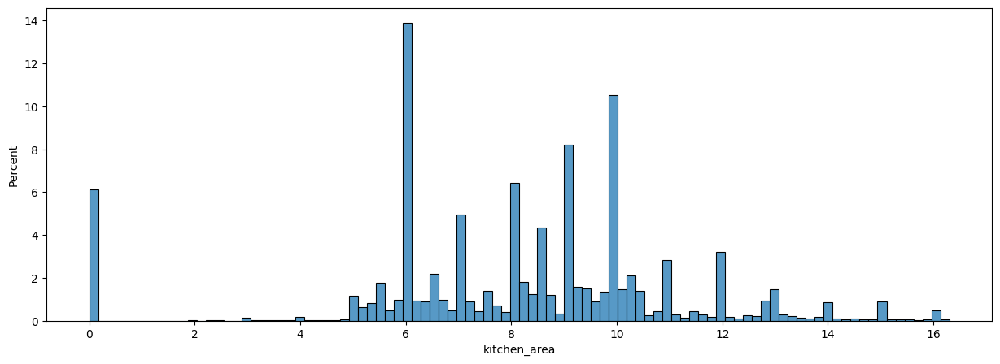

In [14]:
plt.figure(figsize=(15,5))
sns.histplot(data=df,x='kitchen_area',stat='percent');

Наличие объектов с нулевой площадью кухни, скорее всего, объясняется наличием нежилых объектов недвижимости

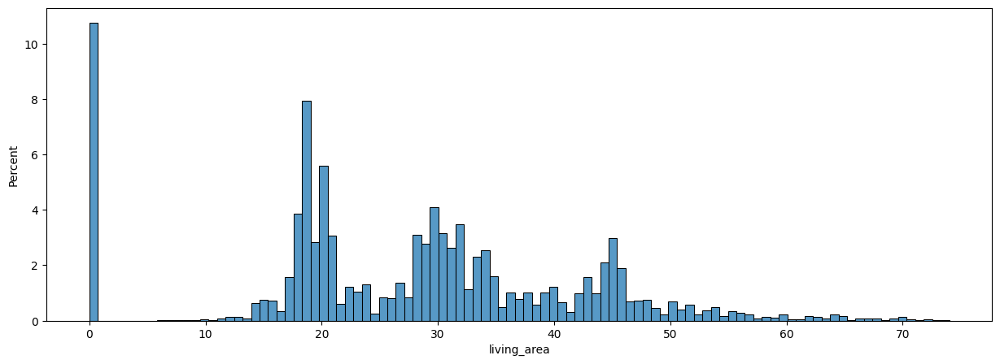

In [15]:
plt.figure(figsize=(15,5))
sns.histplot(data=df,x='living_area',stat='percent');

Как и для *kitchen_area* - присутствие  __10%__ нежилых объектов в наборе данных. Вполне возможно, что это отдельно выделенные кладовые помещения.

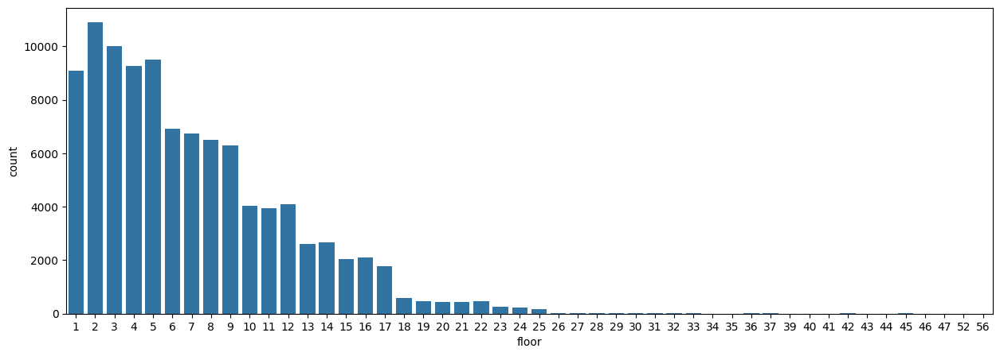

In [16]:
plt.figure(figsize=(15,5))
sns.countplot(data=df,x='floor');

Большая часть объектов распологается в пределах __25__ этажей

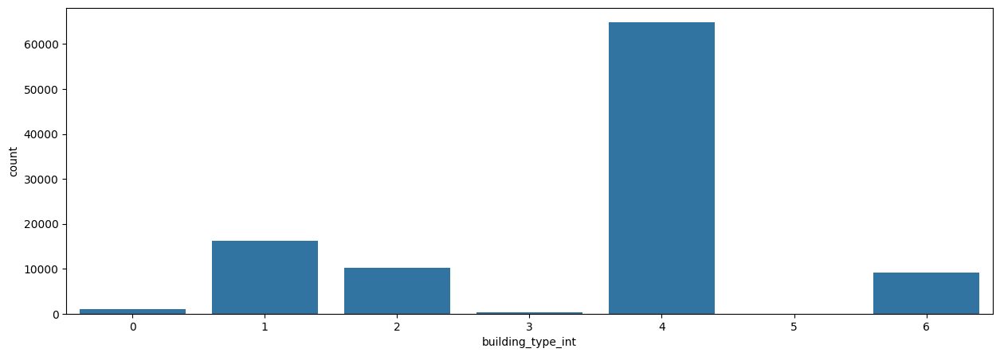

In [17]:
plt.figure(figsize=(15,5))
sns.countplot(data=df,x='building_type_int');

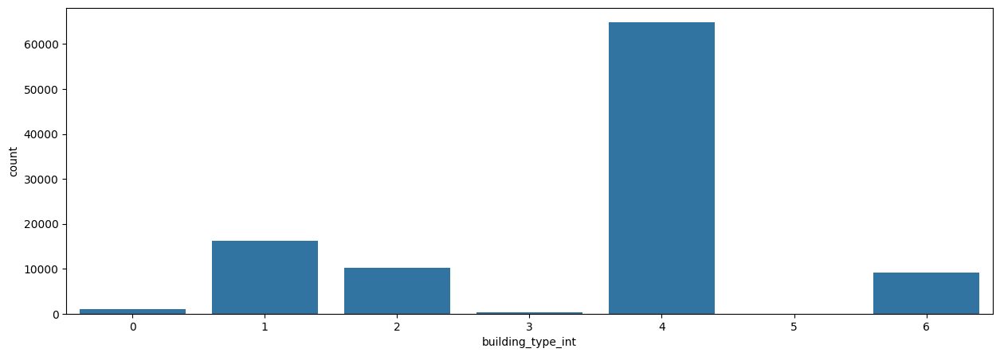

In [18]:
plt.figure(figsize=(15,5))
sns.countplot(data=df,x='building_type_int');

Подавляющее большинство зданий - 4-го типа. Скорее всего жилые дома, построенные по типичным проектам

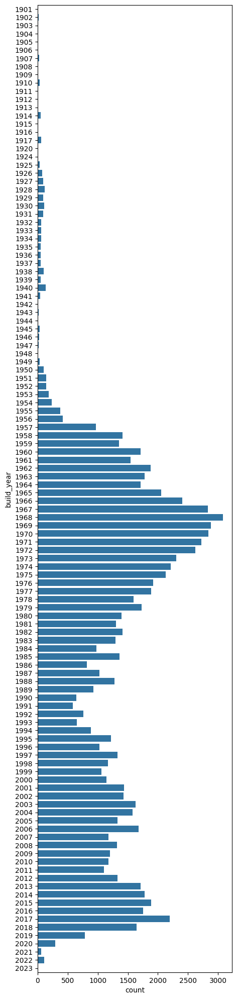

In [19]:
plt.figure(figsize=(5,25))
sns.countplot(data=df,y='build_year');

По гистограмме  можно определить: каких домов больше всего в Москве. Пик приходится на 1968 год - это так называемые "брежневки", панельные дома, построенные по типовым проектам.

В 1990-е можно заметить спад строительства, а затем снова подъём до 2019 года (скорее всего связанный с расширением границ Москвы и программой реновации с 2017 года).

In [20]:
import plotly.graph_objects as go
fig=px.scatter_mapbox(data_frame =df,lat='latitude',lon='longitude',color='price',height=1000,width=1000,zoom=10)
fig.update_layout(mapbox_style="open-street-map")
fig.update_geos(fitbounds="locations")   
# fig = go.Figure(data=go.Scattergeo(
#         lon = df['longitude'],
#         lat = df['latitude'],
#         # text = df['text'],
#         mode = 'markers',
#         marker_color = df['price'],
#         ))

# fig.update_layout(
#         title = 'Most trafficked US airports<br>(Hover for airport names)',
#         geo_scope='europe',
#     )

__Комментарий:__ 

Были изучены распределения основных предикторов. Обнаружены аномальные значения с низким *total_area*< 5 и *kitchen_area* < 5. Есть гипотеза, что это нежилые помещения(кладовые и коммерческие помещения).

Также установлено, что все объёкты витрины данных распологаются в Московской области(абсолютное большинство в Москве) и цена обратно пропорциональна удалённости от центра города. Поэтому,как минимум ,имеет смысл ввести новую фичу - расстояние от центра Москвы. В этом случае, можно будет исключить из витрины координаты (*longitude* и *latitude*)

##### 2.4 Анализ целевой переменной

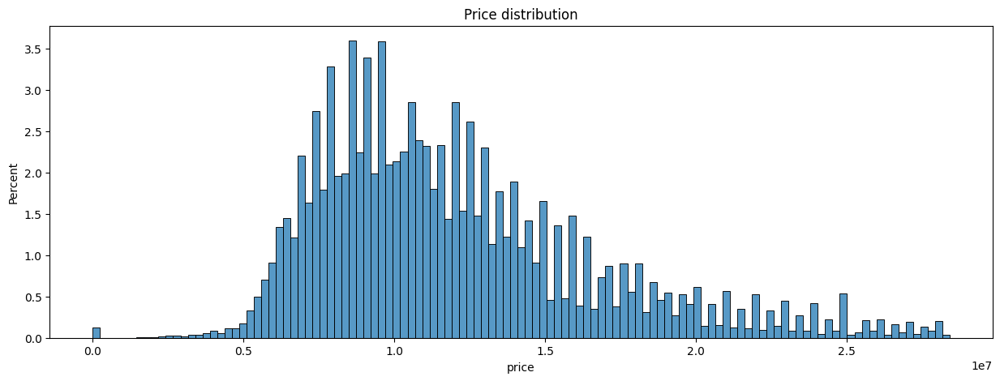

In [21]:
# px.histogram(df.price,title='Price distribution')
plt.figure(figsize=(15,5))
sns.histplot(data=df,x='price',stat='percent');
plt.title('Price distribution');

Аномальные значения меньше 100 тыс. руб. Медианная стоимость приходится на 11-12 млн. руб.

##### 2.5 Анализ целевой переменной в зависимости от различных признаков

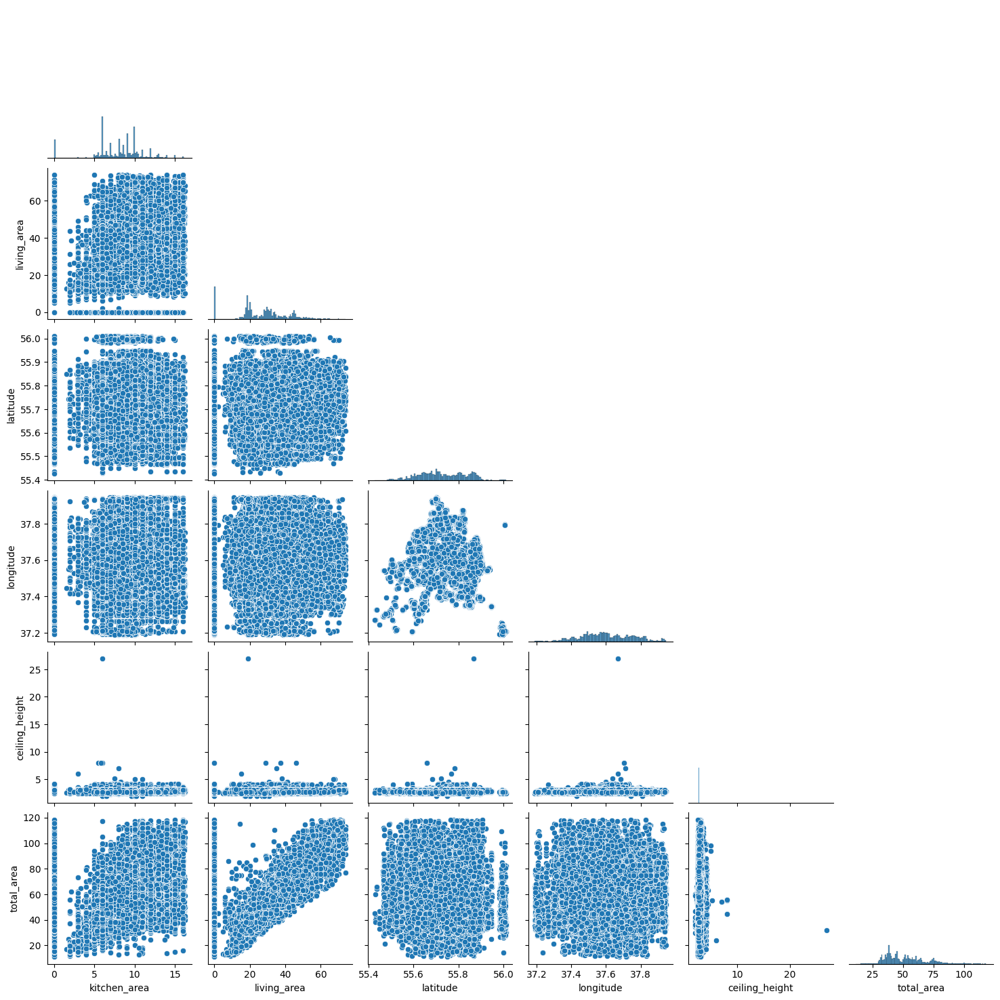

In [22]:
sns.pairplot(data=df[['kitchen_area','living_area','latitude','longitude','ceiling_height','total_area']],corner=True);

Наличие корреляции между *living_area* и *total_area* довольно есстественна

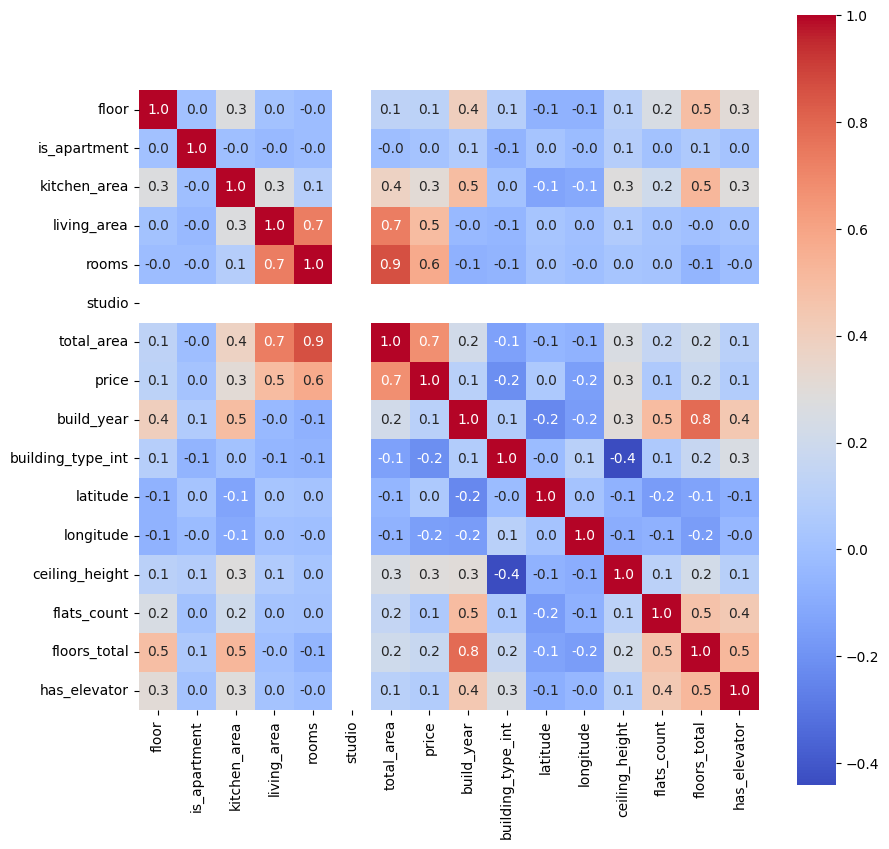

In [23]:
plt.figure(figsize=(10,10))
sns.heatmap(df.corr('spearman'),cmap='coolwarm',square=True,annot=True, fmt=".1f");

In [24]:
px.histogram(df,x='price',title='Price distribution',color="has_elevator",barmode='overlay',histnorm='percent')
# plt.figure(figsize=(15,5))
# sns.histplot(data=df,x='price',stat='percent');
# plt.title('Price distribution');

Квартиры с лифтами, в среднем, дороже 

In [25]:
px.scatter(df,x='price',y='total_area',color="rooms",marginal_x="box")

Прослеживается корреляция между *rooms* и *price*

##### 2.6 Выводы после EDA

1. Недвижимость с лифтами ( *has_elevator*=1 ) стоит в среднем дороже;
2. С ценой недвижимости ( *price* ) больше всего коррелируют кол-во комнат ( *rooms* ) и общая площадь ( *total_area* );
3. Между предикторами *total_area* и *living_area*  присутсвует мультикорреляция. А также между *rooms* и *total_area*;
4. Все объёкты недвижимости расположены в Московской области;
5. В целевой переменной присутсвуют аномальные значения < **100 тыс. руб.**;
6. Необходимо ввести новую переменную - расстояние от центра Москвы.


##### 2.7 Логирование артефактов в MLflow

In [26]:

os.environ["MLFLOW_S3_ENDPOINT_URL"] = "https://storage.yandexcloud.net" #endpoint бакета от YandexCloud
os.environ["AWS_ACCESS_KEY_ID"] = os.getenv("AWS_ACCESS_KEY_ID") # получаем id ключа бакета, к которому подключён MLFlow, из .env
os.environ["AWS_SECRET_ACCESS_KEY"] = os.getenv("AWS_SECRET_ACCESS_KEY") # получаем ключ бакета, к которому подключён MLFlow, из .env

TRACKING_SERVER_HOST = "127.0.0.1"
TRACKING_SERVER_PORT = 5000
RUN_NAME = "EDA_registry_12"
# REGISTRY_MODEL_NAME = "base_price_model_daniil_skorokhodov"
YOUR_NAME = "DANIIL_S" # введите своё имя для создания уникального эксперимента
assert YOUR_NAME, "введите своё имя в переменной YOUR_NAME для создания уникального эксперимента"
EXPERIMENT_NAME = f"{YOUR_NAME}_enhanced_model_registry"
#EXPERIMENT_NAME = f"ML_experiment_{YOUR_NAME}_2"
 
mlflow.set_tracking_uri(f"http://{TRACKING_SERVER_HOST}:{TRACKING_SERVER_PORT}")
mlflow.set_registry_uri(f"http://{TRACKING_SERVER_HOST}:{TRACKING_SERVER_PORT}") 
try:
  experiment_id = mlflow.get_experiment_by_name(EXPERIMENT_NAME).experiment_id
except AttributeError:
  experiment_id = mlflow.create_experiment(EXPERIMENT_NAME)

Прописываем переменные окружения, указываем: названия эксперимента,имя модели, имя запуска, используем локальный сервер для фронта mlflow

In [27]:
with open("results.md", "w") as f:
    f.write("1. Недвижимость с лифтами ( *has_elevator*=1 ) стоит в среднем дороже;\n")
    f.write("2. С ценой недвижимости ( *price* ) больше всего коррелируют кол-во комнат ( *rooms* ) и общая площадь ( *total_area* );\n")
    f.write("3. Между предикторами *total_area* и *living_area*  присутсвует мультикорреляция. А также между *rooms* и *total_area*;\n")
    f.write("4. Все объёкты недвижимости расположены в Московской области;\n")
    f.write("5. В целевой переменной присутсвуют аномальные значения < **100 тыс. руб.**;")

Записываем выводы в Markdown-файл

In [28]:
with mlflow.start_run(run_name=RUN_NAME, experiment_id=experiment_id) as run:
    run_id = run.info.run_id
    mlflow.log_artifact("../model_improvement/project_template_sprint_2.ipynb")
    mlflow.log_artifact("results.md")
    

Логируем ноутбук и файл c выводами в один эксперимент с одним и тем же run_id

На этом этапе 

#### Этап 3: Генерация Признаков и Обучение Новой Версии Модели
После тщательного исследовательского анализа данных (EDA), вы, скорее всего, сформировали несколько гипотез относительно новых признаков, которые могут улучшить качество вашей модели. На этом этапе, мы предлагаем вам приступить к генерации новых признаков и последующему обучению модели, используя два подхода:

Ручная генерация признаков: Используйте ваше понимание данных и результаты EDA для создания новых признаков.
Автоматическая генерация признаков: Воспользуйтесь библиотеками для автоматической генерации признаков, чтобы облегчить и ускорить этот процесс.
Важно: Для признаков, созданных вручную, рекомендуется использовать объекты sklearn, такие как Pipeline и ColumnTransformer. Это позволит автоматизировать процесс преобразования данных и облегчить поддержку вашего проекта.

После генерации новых признаков, наступает время обучить новую версию вашей модели, используя эти признаки. Не забудьте залогировать все результаты, включая новые признаки, параметры модели и метрики качества, в MLflow для удобства отслеживания изменений и результатов.

Рекомендуемые шаги:

- Определение и генерация новых признаков на основе ваших гипотез.
- Использование библиотек для автоматической генерации признаков, если это применимо.
- Интеграция новых признаков в вашу модель с помощью Pipeline или ColumnTransformer для ручно созданных признаков.
- Обучение новой версии модели с использованием всех доступных признаков.
- Логирование результатов в MLflow для документирования и анализа эффективности новых признаков и модели.

Этот этап проекта критически важен для повышения точности и эффективности вашей модели. Тщательная работа на этом этапе может существенно повлиять на итоговое качество моделирования.


##### 3.1 ручная генерация признаков


Координаты центра города: **55.752133**° с.ш. и **37.621316**° в.д.

In [29]:
# Вычисление расстояния от центра Москвы
def euclid_dist(coordinates):
    lat,lon = coordinates
    lat_city_center= 55.752133
    lon_city_center = 37.621316
    dist = ((lat-lat_city_center)**2 + (lon-lon_city_center)**2)**0.5
    return dist

In [30]:
df['distance_from_center']=df[['latitude','longitude']].apply(euclid_dist,axis=1)

Добавим новую фичу - расстояние от центра города

In [31]:
df.loc[df['living_area']==0,'non_living_realty']=1
df.loc[df['living_area']>0,'non_living_realty']=0

Выделим нежилые помещения в отдельную категорию

In [32]:
df.loc[df['floor']==df['floors_total'],'is_last_floor']=1
df.loc[df['floor']!=df['floors_total'],'is_last_floor']=0

Выделим объекты на последнем этаже здания в отдельную категорию (они обычно отличаются в цене)

In [33]:
df.loc[:,'total_area_per_room'] = df['total_area']/df['rooms']
df.loc[:,'living_area_per_room'] = df['living_area']/df['rooms']

Между *living_area*, *total_area* и *rooms* взаимная корреляция. Для того чтобы избавиться от мультикоррелирующих признаков введём новую переменную - средняя площадь на 1 комнату

Из открытого доступа можно добавить данные c ближайшей станцией метро 

In [34]:
import urllib.request, json
with urllib.request.urlopen("https://api.hh.ru/metro/1") as url:
    data_subway = json.load(url)['lines']
    # print(data_subway)

In [35]:
coor_dic=dict()
for line in data_subway:
    # print(f"Line ID: {line['id']}, Name: {line['name']}, Color: #{line['hex_color']}")
    for station in line['stations']:
        coor_dic[station['name']] = [station['line']['name'],station['lat'],station['lng']]

In [36]:
data_subway=pd.DataFrame(coor_dic).T.reset_index().rename({0:'line',1:'latitude',2:'longitude','index':'station'},axis=1)

In [37]:
data_subway

,station,line,latitude,longitude
0,Новокосино,Калининская,55.745113,37.864052
1,Новогиреево,МЦД-4,55.744444,37.818333
2,Перово,МЦД-3,55.735556,37.765
3,Шоссе Энтузиастов,МЦК,55.758633,37.748477
4,Авиамоторная,МЦД-3,55.750278,37.721944
...,...,...,...,...
349,Кокошкино,МЦД-4,55.599722,37.171389
350,Санино,МЦД-4,55.583889,37.138333
351,Крёкшино,МЦД-4,55.577778,37.109722
352,Победа,МЦД-4,55.566111,37.093056


In [38]:
def closest_subway_station(data):
    distances = (((data['latitude']-data_subway['latitude'])**2 + (data['longitude'] - data_subway['longitude'])**2)**0.5).values
    closest_station = data_subway.iloc[distances.argmin()]['station']
    closest_line = data_subway.iloc[distances.argmin()]['line']
    closest_station_distance = distances.min()
    return np.array([closest_station,closest_line,closest_station_distance])

In [39]:
sub_data=df.apply(closest_subway_station,axis=1)

In [40]:
sub_data

0              [Окская, Некрасовская, 0.011488820237676774]
1               [Марьина Роща, МЦД-4, 0.012413201283626097]
2                     [Перово, МЦД-3, 0.005542708029297219]
3         [Преображенская площадь, Сокольническая, 0.013...
4               [Нижегородская, МЦД-4, 0.01611473542922889]
                                ...                        
101776           [Новогиреево, МЦД-4, 0.016741675158233632]
101777               [Плющево, МЦД-3, 0.006297912296402167]
101778         [Раменки, Солнцевская, 0.008366532147541557]
101779     [Некрасовка, Некрасовская, 0.013509444113560044]
101780    [Бабушкинская, Калужско-Рижская, 0.02666602527...
Length: 101781, dtype: object

In [41]:
stations = sub_data.apply(lambda x: x[0])
lines = sub_data.apply(lambda x: x[1])
values = sub_data.apply(lambda x: x[2])

# Создание DataFrame
sub_data = pd.DataFrame({
    # 'closest_station': stations,
    # 'closest_line': lines,
    'closest_station_distance': values
})


In [42]:
df=df.join(sub_data)

In [43]:
df['closest_station_distance']=df['closest_station_distance'].astype(float)
# df['rooms'] = df['rooms'].astype('category')

##### 3.2 оборачивание всех преобразований в объекты sklearn

In [44]:
from sklearn.preprocessing import StandardScaler,TargetEncoder,FunctionTransformer,PolynomialFeatures,KBinsDiscretizer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.compose import ColumnTransformer
from catboost import CatBoostRegressor

In [45]:
# df=df.drop(['latitude','longitude','closest_line'],axis=1)

In [46]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101781 entries, 0 to 101780
Data columns (total 22 columns):
 #   Column                    Non-Null Count   Dtype   
---  ------                    --------------   -----   
 0   floor                     101781 non-null  category
 1   is_apartment              101781 non-null  int64   
 2   kitchen_area              101781 non-null  float64 
 3   living_area               101781 non-null  float64 
 4   rooms                     101781 non-null  int64   
 5   studio                    101781 non-null  float64 
 6   total_area                101781 non-null  float64 
 7   price                     101781 non-null  float64 
 8   build_year                101781 non-null  int64   
 9   building_type_int         101781 non-null  category
 10  latitude                  101781 non-null  float64 
 11  longitude                 101781 non-null  float64 
 12  ceiling_height            101781 non-null  float64 
 13  flats_count               101

In [47]:
#df=df.drop(['closest_line'],axis=1)

In [48]:
# cat_vars = ['floor','building_type_int','closest_station','rooms','has_elevator','non_living_realty','is_last_floor','closest_line']
num_vars = ['kitchen_area','living_area','flats_count','floors_total','distance_from_center','total_area_per_room','living_area_per_room','total_area','ceiling_height','closest_station_distance','build_year','latitude','longitude']
all_vars = df.drop(['price','studio'],axis=1).columns.to_list()

In [49]:
df['floor']=df['floor'].astype(int)
df['rooms'] = df['rooms'].astype(int)
df['building_type_int'] = df['building_type_int'].astype(int)
# df['closest_station'] = df['closest_station'].astype('str')
# df['closest_line'] = df['closest_line'].astype('str')
df['is_last_floor'] = df['is_last_floor'].astype('int8')
df['non_living_realty'] = df['non_living_realty'].astype('int8')
df['price'] = df['price'].astype(int)

In [50]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101781 entries, 0 to 101780
Data columns (total 22 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   floor                     101781 non-null  int64  
 1   is_apartment              101781 non-null  int64  
 2   kitchen_area              101781 non-null  float64
 3   living_area               101781 non-null  float64
 4   rooms                     101781 non-null  int64  
 5   studio                    101781 non-null  float64
 6   total_area                101781 non-null  float64
 7   price                     101781 non-null  int64  
 8   build_year                101781 non-null  int64  
 9   building_type_int         101781 non-null  int64  
 10  latitude                  101781 non-null  float64
 11  longitude                 101781 non-null  float64
 12  ceiling_height            101781 non-null  float64
 13  flats_count               101781 non-null  i

In [51]:
df=df.drop(['studio'],axis=1)

In [52]:
df.shape

(101781, 21)

In [53]:
X_train, X_test, y_train, y_test = train_test_split(df.drop([target],axis=1), df[target], test_size=0.2, shuffle=True)

ct = ColumnTransformer(
    [
        # ("Encoder", TargetEncoder(target_type='continuous'), cat_vars),
     ('feature_generator',PolynomialFeatures(degree=2),all_vars),
     ("Scaler", StandardScaler(), all_vars),
    #  ('feature_generator',PolynomialFeatures(),all_vars)
     ])
pipe =Pipeline([
('preprocessing',ct),
('fitting',CatBoostRegressor(loss_function='MAE',devices=-1))
    
]

)

In [54]:
X_train.shape

(81424, 20)

In [55]:
X_train.isna().sum()

floor                       0
is_apartment                0
kitchen_area                0
living_area                 0
rooms                       0
total_area                  0
build_year                  0
building_type_int           0
latitude                    0
longitude                   0
ceiling_height              0
flats_count                 0
floors_total                0
has_elevator                0
distance_from_center        0
non_living_realty           0
is_last_floor               0
total_area_per_room         0
living_area_per_room        0
closest_station_distance    0
dtype: int64

##### 3.3 автоматическая генерация признаков

In [56]:
from autofeat import AutoFeatRegressor
transformations = [ 'sqrt','1/','log']

preproc = AutoFeatRegressor(transformations=transformations,max_gb=16,n_jobs=-1)
X_tr_transformed=preproc.fit_transform(X_train,y_train)
X_test_transformed= preproc.transform(X_test)

Инициализируем _AutoFeatRegressor_ для фичей

 Поэтому далее буду рассматривать только сгенерированные вручную фичи

##### 3.4 обучение новой версии модели

In [57]:
X_test_transformed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20357 entries, 0 to 20356
Columns: 102 entries, floor to sqrt(closest_station_distance)*distance_from_center
dtypes: float64(102)
memory usage: 15.8 MB


In [58]:
mae_cross_val=abs(cross_val_score(estimator=pipe,X=X_tr_transformed,y=y_train,scoring='neg_mean_absolute_error',n_jobs=-1,cv=5))

0:	learn: 3439481.7730081	total: 255ms	remaining: 4m 14s
1:	learn: 3380439.7424162	total: 412ms	remaining: 3m 25s
2:	learn: 3326162.7356393	total: 615ms	remaining: 3m 24s
3:	learn: 3274661.0075977	total: 797ms	remaining: 3m 18s
4:	learn: 3224612.0814209	total: 987ms	remaining: 3m 16s
5:	learn: 3175706.7064809	total: 1.16s	remaining: 3m 12s
6:	learn: 3129771.9253704	total: 1.35s	remaining: 3m 10s
7:	learn: 3085482.7764298	total: 1.53s	remaining: 3m 9s
8:	learn: 3042656.0254550	total: 1.71s	remaining: 3m 7s
9:	learn: 3000282.6534024	total: 1.89s	remaining: 3m 6s
10:	learn: 2961140.3044700	total: 2.07s	remaining: 3m 5s
11:	learn: 2923896.3353897	total: 2.24s	remaining: 3m 4s
12:	learn: 2887992.2039825	total: 2.41s	remaining: 3m 3s
13:	learn: 2854798.9370057	total: 2.57s	remaining: 3m 1s
14:	learn: 2821122.2690067	total: 2.74s	remaining: 2m 59s
0:	learn: 3442455.3310856	total: 271ms	remaining: 4m 30s
15:	learn: 2789033.4628479	total: 2.94s	remaining: 3m 1s
1:	learn: 3386532.0573473	total: 

In [59]:
mae_cross_val.mean()

1887370.7692440853

In [60]:
pipe.fit(X_tr_transformed,y_train)

0:	learn: 3444728.9873968	total: 171ms	remaining: 2m 50s
1:	learn: 3385753.9320123	total: 272ms	remaining: 2m 15s
2:	learn: 3331232.0008870	total: 388ms	remaining: 2m 8s
3:	learn: 3277122.8000758	total: 506ms	remaining: 2m 5s
4:	learn: 3226643.3429061	total: 619ms	remaining: 2m 3s
5:	learn: 3177859.0749805	total: 725ms	remaining: 2m
6:	learn: 3130982.7263407	total: 833ms	remaining: 1m 58s
7:	learn: 3086700.3530439	total: 941ms	remaining: 1m 56s
8:	learn: 3043239.4782111	total: 1.05s	remaining: 1m 55s
9:	learn: 3001033.8042393	total: 1.16s	remaining: 1m 55s
10:	learn: 2960779.4665228	total: 1.28s	remaining: 1m 55s
11:	learn: 2923281.4184043	total: 1.39s	remaining: 1m 54s
12:	learn: 2888086.9704617	total: 1.51s	remaining: 1m 54s
13:	learn: 2855112.0653946	total: 1.62s	remaining: 1m 54s
14:	learn: 2822119.3803766	total: 1.73s	remaining: 1m 53s
15:	learn: 2790419.4536776	total: 1.84s	remaining: 1m 53s
16:	learn: 2760151.9987926	total: 1.95s	remaining: 1m 52s
17:	learn: 2731814.0442424	tota

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('feature_generator',
                                                  PolynomialFeatures(),
                                                  ['floor', 'is_apartment',
                                                   'kitchen_area',
                                                   'living_area', 'rooms',
                                                   'total_area', 'build_year',
                                                   'building_type_int',
                                                   'latitude', 'longitude',
                                                   'ceiling_height',
                                                   'flats_count',
                                                   'floors_total',
                                                   'has_elevator',
                                                   'distance_from_center',
                                                   'non_living_realty',
                                                   'is_last_...
                                                   'living_area', 'rooms',
                                                   'total_area', 'build_year',
                                                   'building_type_int',
                                                   'latitude', 'longitude',
                                                   'ceiling_height',
                                                   'flats_count',
                                                   'floors_total',
                                                   'has_elevator',
                                                   'distance_from_center',
                                                   'non_living_realty',
                                                   'is_last_floor',
                                                   'total_area_per_room',
                                                   'living_area_per_room',
                                                   'closest_station_distance'])])),
                ('fitting',
                 <catboost.core.CatBoostRegressor object at 0x7f591593c070>)])

In [61]:
preds=pipe.predict(X_test)

In [62]:
from sklearn.metrics import mean_absolute_error,mean_absolute_percentage_error,mean_squared_error

In [63]:
mean_absolute_error(y_test,preds)

1915574.9345493335

In [64]:
mean_absolute_percentage_error(y_test,preds)

40.3237963280869

In [65]:
mean_squared_error(y_test,preds)

6426393406847.232

Результат немного улучшился.

##### 3.5 логирование артефактов в MLflow

In [66]:

os.environ["MLFLOW_S3_ENDPOINT_URL"] = "https://storage.yandexcloud.net" #endpoint бакета от YandexCloud
os.environ["AWS_ACCESS_KEY_ID"] = os.getenv("AWS_ACCESS_KEY_ID") # получаем id ключа бакета, к которому подключён MLFlow, из .env
os.environ["AWS_SECRET_ACCESS_KEY"] = os.getenv("AWS_SECRET_ACCESS_KEY") # получаем ключ бакета, к которому подключён MLFlow, из .env

TRACKING_SERVER_HOST = "127.0.0.1"
TRACKING_SERVER_PORT = 5000
RUN_NAME = "Feature_engineering_registry_3"
REGISTRY_MODEL_NAME = "Feature_engineering_price_model_dvs"
YOUR_NAME = "DANIIL_S" # введите своё имя для создания уникального эксперимента
assert YOUR_NAME, "введите своё имя в переменной YOUR_NAME для создания уникального эксперимента"
# EXPERIMENT_NAME = f"{YOUR_NAME}_Feature_engineering_registry_2"
#EXPERIMENT_NAME = f"ML_experiment_{YOUR_NAME}_2"
 
mlflow.set_tracking_uri(f"http://{TRACKING_SERVER_HOST}:{TRACKING_SERVER_PORT}")
mlflow.set_registry_uri(f"http://{TRACKING_SERVER_HOST}:{TRACKING_SERVER_PORT}") 
try:
  experiment_id = mlflow.get_experiment_by_name(EXPERIMENT_NAME).experiment_id
except AttributeError:
  experiment_id = mlflow.create_experiment(EXPERIMENT_NAME)

Прописываем переменные окружения, указываем: названия эксперимента,имя модели, имя запуска, используем локальный сервер для фронта mlflow

In [67]:
pip_requirements = '../requirements.txt'
signature = mlflow.models.infer_signature(X_test, preds)
input_example = X_test[:10]
metadata = {'model_type': 'monthly'}
 
with mlflow.start_run(run_name=RUN_NAME, experiment_id=experiment_id) as run:
    run_id = run.info.run_id

/home/mle-user/mle_projects/mle_final_projects/mle-project-sprint-2-v001/.venv_mlflow_project/lib/python3.10/site-packages/mlflow/models/signature.py:212: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.



In [68]:
model_info = mlflow.sklearn.log_model(
        sk_model=pipe,
        artifact_path="model",
        registered_model_name=REGISTRY_MODEL_NAME,
        await_registration_for=60,
        pip_requirements=pip_requirements,
        metadata=metadata,
        signature=signature,
        input_example=input_example
    )
mlflow.log_artifact("../model_improvement/project_template_sprint_2.ipynb")

Registered model 'Feature_engineering_price_model_dvs' already exists. Creating a new version of this model...
2024/06/10 13:29:33 INFO mlflow.tracking._model_registry.client: Waiting up to 60 seconds for model version to finish creation. Model name: Feature_engineering_price_model_dvs, version 6
Created version '6' of model 'Feature_engineering_price_model_dvs'.


На этом этапе сгенерированны предикторы: как вручную, так и с помощью пакета _autofeat_. Далее пайплайн с моделью был переобучен на новых фичах, получены соответствующие значения метрик. ПРоцесс и результат залогирован в отдельном эксперименте

#### Этап 4: Отбор Признаков и Обучение Новой Версии Модели
Создание новых признаков — это лишь часть работы. Следующий важный шаг — это убедиться в том, что каждый из этих признаков действительно вносит положительный вклад в качество модели. Некоторые признаки могут оказывать отрицательное влияние на модель, поэтому их следует исключить из анализа.

На этом этапе, мы рекомендуем вам применить различные методы отбора признаков для того, чтобы определить и удалить те признаки, которые не улучшают качество вашей модели. Цель этого этапа — максимизировать производительность модели, удалив избыточные или неинформативные признаки.

После тщательного отбора признаков, пора обучить новую версию вашей модели, уже без негативно влияющих на неё признаков. Важно залогировать результаты этого этапа, включая измененный набор признаков, параметры модели и полученные метрики качества, в MLflow для последующего анализа и сравнения.

Рекомендуемые шаги:

- Применение методов отбора признаков для идентификации и исключения признаков, ухудшающих качество модели.
- Анализ влияния каждого признака на модель, чтобы понять, какие из них наиболее ценные.
- Обучение новой версии модели без негативно влияющих признаков.
- Логирование всех изменений и результатов в MLflow, включая конечный набор признаков, параметры модели и метрики качества.

Этот этап не только поможет улучшить качество вашей модели, но и даст глубокое понимание о важности и влиянии отдельных признаков на результаты моделирования.


##### 4.1 Отбор признаков при помощи метода номер 1

In [69]:
# EXPERIMENT_NAME = 'Feature_selection_1'
RUN_NAME = "feature_selection_registry"
REGISTRY_MODEL_NAME = 'Feature_engineering_price_model_dvs'
FS_ASSETS = "fs_assets" 

In [70]:
X_tr_transformed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81424 entries, 0 to 81423
Columns: 102 entries, floor to sqrt(closest_station_distance)*distance_from_center
dtypes: float64(102)
memory usage: 63.4 MB


In [71]:
from mlxtend.feature_selection import SequentialFeatureSelector
from sklearn.linear_model import LinearRegression

 
# Инициализация Sequential backward Feature Selector
sbfs = SequentialFeatureSelector(LinearRegression(),
           k_features=(6,8),  # Диапазон признаков с минимум 6 до 8
           forward=False,
           floating=False,
           scoring='neg_mean_squared_error',
           n_jobs=-1,
           cv=2)
sbfs.fit(X_tr_transformed, y_train)

SequentialFeatureSelector(cv=2, estimator=LinearRegression(), forward=False,
                          k_features=(6, 8), n_jobs=-1,
                          scoring='neg_mean_squared_error')

In [72]:
X_tr_transformed.head()

,floor,is_apartment,kitchen_area,living_area,rooms,total_area,build_year,building_type_int,latitude,longitude,...,log(distance_from_center)/floors_total,1/(closest_station_distance*flats_count),sqrt(closest_station_distance)*kitchen_area,building_type_int*log(distance_from_center),sqrt(closest_station_distance)/floors_total,sqrt(building_type_int)/distance_from_center,closest_station_distance/distance_from_center,sqrt(kitchen_area)*sqrt(living_area_per_room),building_type_int*sqrt(closest_station_distance),sqrt(closest_station_distance)*distance_from_center
0,14.0,0.0,10.00,43.099998,3.0,76.400002,2001.0,4.0,55.872353,37.497196,...,-0.103273,0.364013,1.109914,-7.022573,0.006529,11.574338,0.071293,11.986103,0.443966,0.019179
1,5.0,0.0,12.00,33.000000,2.0,63.500000,2013.0,2.0,55.567223,37.443172,...,-0.169950,0.466809,1.424590,-2.719208,0.014839,5.507867,0.054889,14.071247,0.237432,0.030482
2,5.0,0.0,8.39,30.820000,2.0,52.279999,1976.0,4.0,55.884701,37.689087,...,-0.119036,0.333855,1.397241,-7.618291,0.010409,13.433075,0.186279,11.370572,0.666146,0.024795
3,5.0,0.0,7.00,44.000000,3.0,60.000000,1963.0,4.0,55.686222,37.680267,...,-0.485113,0.718693,0.760126,-9.702267,0.021718,22.617273,0.133348,10.132456,0.434357,0.009602
4,11.0,0.0,13.80,33.700001,2.0,65.199997,2017.0,4.0,55.704033,37.940857,...,-0.045187,0.119721,1.661812,-4.518668,0.004817,6.189251,0.044876,15.248935,0.481685,0.038913


In [73]:
X_tr_transformed.columns[list(sbfs.k_feature_idx_)]

Index(['total_area', 'latitude', 'longitude', 'total_area/floor',
       'sqrt(longitude)/latitude', 'log(ceiling_height)*log(total_area)',
       'sqrt(total_area)*log(distance_from_center)',
       'sqrt(floors_total)*log(closest_station_distance)'],
      dtype='object')

In [74]:
# Выбор признаков с помощью SBFS
selected_features_sbfs = X_tr_transformed[X_tr_transformed.columns[list(sbfs.k_feature_idx_)]]

In [75]:
selected_features_sbfs

,total_area,latitude,longitude,total_area/floor,sqrt(longitude)/latitude,log(ceiling_height)*log(total_area),sqrt(total_area)*log(distance_from_center),sqrt(floors_total)*log(closest_station_distance)
0,76.400002,55.872353,37.497196,5.457143,0.109598,4.370488,-15.345567,-18.127666
1,63.500000,55.567223,37.443172,12.700000,0.110120,4.696495,-10.834259,-12.054883
2,52.279999,55.884701,37.689087,10.456000,0.109854,3.840997,-13.770996,-14.340329
3,60.000000,55.686222,37.680267,12.000000,0.110232,3.974704,-18.788359,-9.928954
4,65.199997,55.704033,37.940857,5.927272,0.110578,4.149269,-9.121666,-21.167601
...,...,...,...,...,...,...,...,...
81419,30.100000,55.847401,37.434757,7.525000,0.109556,3.092189,-8.575967,-11.336255
81420,53.000000,55.708279,37.783337,13.250000,0.110339,3.854276,-12.992665,-15.258069
81421,51.000000,55.894115,37.538044,17.000000,0.109615,3.905293,-12.884818,-12.929604
81422,39.000000,55.775272,37.822559,4.333333,0.110264,3.556509,-9.971221,-13.114168


##### 4.2 Отбор признаков при помощи метода номер 2

In [76]:
# Инициализация Sequential Forward Feature Selector 
sffs = SequentialFeatureSelector(LinearRegression(),
           k_features=(6,8),  # Диапазон признаков с минимум 6 до 8
           forward=True,
           floating=False,
           scoring='neg_mean_squared_error',
           n_jobs=-1,
           cv=2)
 
# Обучение SBFS на обучающем наборе
sffs.fit(X_tr_transformed, y_train)
 
# Выбор признаков с помощью SBFS
selected_features_sffs = X_tr_transformed[X_tr_transformed.columns[list(sffs.k_feature_idx_)]]
 

In [77]:
selected_features_sffs.head()

,total_area,total_area/floor,floors_total*log(rooms),sqrt(longitude)/latitude,sqrt(build_year)/longitude,log(ceiling_height)*log(total_area),sqrt(total_area)*log(distance_from_center),building_type_int*sqrt(closest_station_distance)
0,76.400002,5.457143,18.676409,0.109598,1.192957,4.370488,-15.345567,0.443966
1,63.500000,12.700000,5.545177,0.110120,1.198255,4.696495,-10.834259,0.237432
2,52.279999,10.456000,11.090355,0.109854,1.179445,3.840997,-13.770996,0.666146
3,60.000000,12.000000,5.493061,0.110232,1.175834,3.974704,-18.788359,0.434357
4,65.199997,5.927272,17.328680,0.110578,1.183711,4.149269,-9.121666,0.481685


In [78]:
selected_features=X_tr_transformed.columns[list(set(sffs.k_feature_idx_+ sbfs.k_feature_idx_))]

In [79]:
# list(set(sffs.k_feature_idx_+ sbfs.k_feature_idx_))
top_sbfs = X_tr_transformed.columns[list(sbfs.k_feature_idx_)]
top_sffs = X_tr_transformed.columns[list(sffs.k_feature_idx_)]

In [80]:
interc_features = list(set(top_sbfs) & set(top_sffs)) # ваш код здесь #
union_features = list(set(top_sbfs) | set(top_sffs))# ваш код здесь #

In [81]:
sbfs_df = pd.DataFrame.from_dict(sbfs.get_metric_dict()).T
sffs_df = pd.DataFrame.from_dict(sffs.get_metric_dict()).T 

In [83]:
# os.mkdir(FS_ASSETS)
sbfs_df.to_csv(f"{FS_ASSETS}/sbfs.csv")
sffs_df.to_csv(f"{FS_ASSETS}/sffs.csv") 

##### 4.3 Анализ отобранных признаков при помощи двух методов и формирование финального списка с признаками для модели

In [84]:
X_tr_transformed[selected_features].head()

,log(ceiling_height)*log(total_area),building_type_int*sqrt(closest_station_distance),total_area,sqrt(total_area)*log(distance_from_center),sqrt(floors_total)*log(closest_station_distance),latitude,longitude,total_area/floor,floors_total*log(rooms),sqrt(longitude)/latitude,sqrt(build_year)/longitude
0,4.370488,0.443966,76.400002,-15.345567,-18.127666,55.872353,37.497196,5.457143,18.676409,0.109598,1.192957
1,4.696495,0.237432,63.500000,-10.834259,-12.054883,55.567223,37.443172,12.700000,5.545177,0.110120,1.198255
2,3.840997,0.666146,52.279999,-13.770996,-14.340329,55.884701,37.689087,10.456000,11.090355,0.109854,1.179445
3,3.974704,0.434357,60.000000,-18.788359,-9.928954,55.686222,37.680267,12.000000,5.493061,0.110232,1.175834
4,4.149269,0.481685,65.199997,-9.121666,-21.167601,55.704033,37.940857,5.927272,17.328680,0.110578,1.183711


In [85]:
from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs

График для *Sequential Forward Feature Selector*

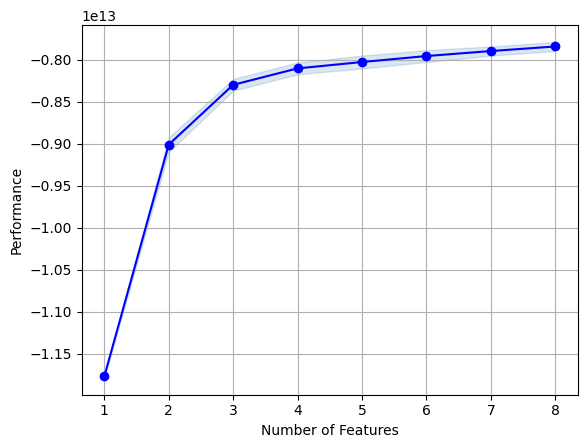

In [86]:
plot_sfs(sffs.get_metric_dict(),kind='std_dev');
# plt.ylim([])
plt.grid()
plt.savefig(f"{FS_ASSETS}/sffs.png") 

График для *Sequential Backrward Feature Selector*

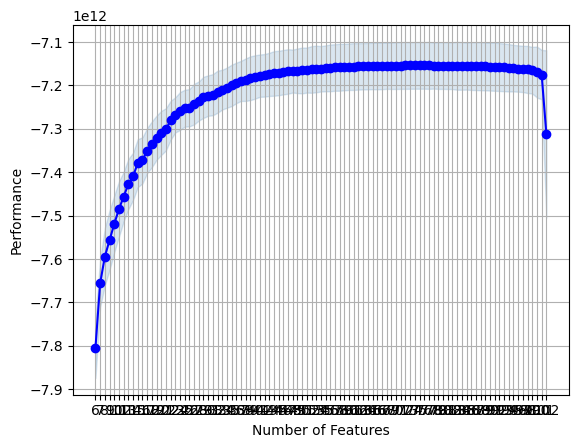

In [87]:
plot_sfs(sbfs.get_metric_dict(),kind='std_dev');
# plt.ylim([])
plt.grid()
plt.savefig(f"{FS_ASSETS}/sbfs.png") 

Рассмотрим взаимосвязи отобранных фичей друг с другом и таргетом

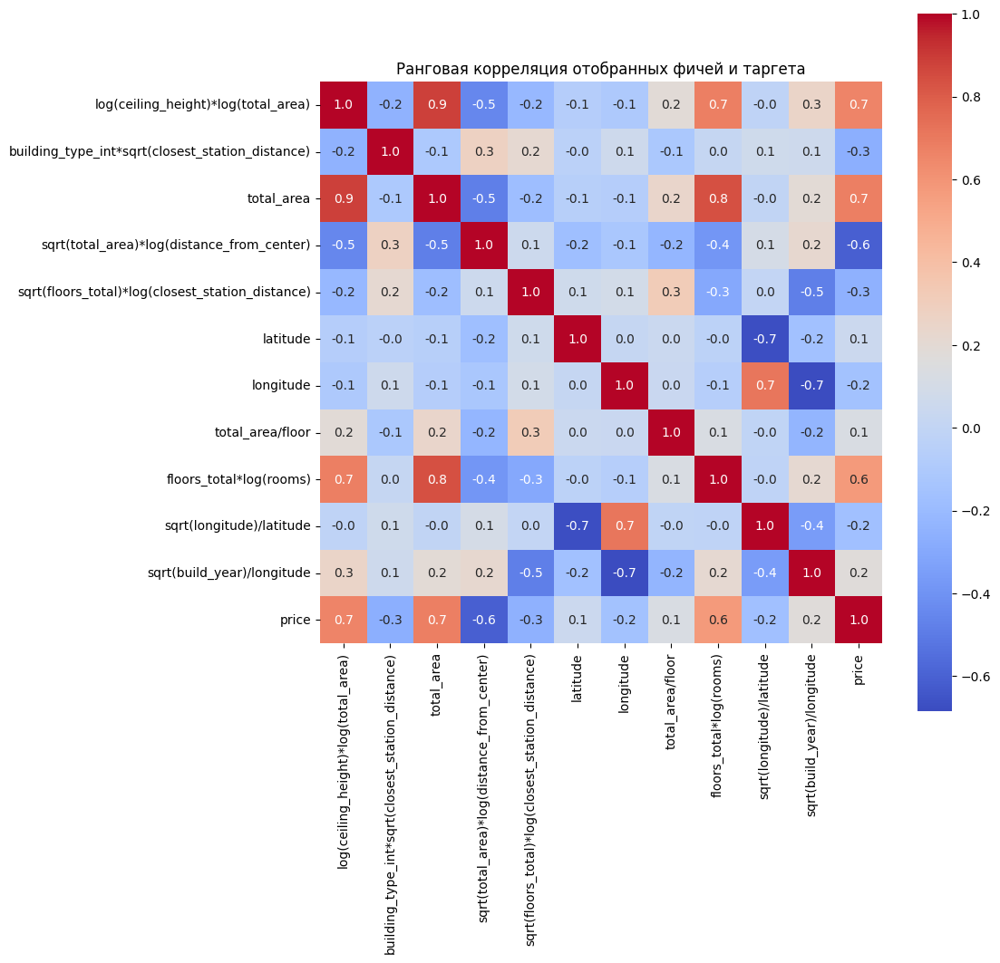

In [88]:
plt.figure(figsize=(10,10))
sns.heatmap(pd.concat([X_tr_transformed[selected_features],y_train.reset_index(drop=True)],axis=1).corr('spearman'),cmap='coolwarm',fmt='.1f',annot=True,square=True,linecolor='black');
plt.title('Ранговая корреляция отобранных фичей и таргета');

В финальный список попали как интерпретируемые фичи, так и нет 


Заметно появление предикторов, учитывающих произведение расстояния до ближайшего метро и общей площади, - что вполне укладывается в формирование стоимости недвижимости.


##### 4.4 Обучение новой версии модели

In [89]:
selected_features

Index(['log(ceiling_height)*log(total_area)',
       'building_type_int*sqrt(closest_station_distance)', 'total_area',
       'sqrt(total_area)*log(distance_from_center)',
       'sqrt(floors_total)*log(closest_station_distance)', 'latitude',
       'longitude', 'total_area/floor', 'floors_total*log(rooms)',
       'sqrt(longitude)/latitude', 'sqrt(build_year)/longitude'],
      dtype='object')

In [90]:
X_tr_transformed[selected_features]

,log(ceiling_height)*log(total_area),building_type_int*sqrt(closest_station_distance),total_area,sqrt(total_area)*log(distance_from_center),sqrt(floors_total)*log(closest_station_distance),latitude,longitude,total_area/floor,floors_total*log(rooms),sqrt(longitude)/latitude,sqrt(build_year)/longitude
0,4.370488,0.443966,76.400002,-15.345567,-18.127666,55.872353,37.497196,5.457143,18.676409,0.109598,1.192957
1,4.696495,0.237432,63.500000,-10.834259,-12.054883,55.567223,37.443172,12.700000,5.545177,0.110120,1.198255
2,3.840997,0.666146,52.279999,-13.770996,-14.340329,55.884701,37.689087,10.456000,11.090355,0.109854,1.179445
3,3.974704,0.434357,60.000000,-18.788359,-9.928954,55.686222,37.680267,12.000000,5.493061,0.110232,1.175834
4,4.149269,0.481685,65.199997,-9.121666,-21.167601,55.704033,37.940857,5.927272,17.328680,0.110578,1.183711
...,...,...,...,...,...,...,...,...,...,...,...
81419,3.092189,0.079273,30.100000,-8.575967,-11.336255,55.847401,37.434757,7.525000,0.000000,0.109556,1.182641
81420,3.854276,0.442189,53.000000,-12.992665,-15.258069,55.708279,37.783337,13.250000,0.000000,0.110339,1.173523
81421,3.905293,0.203415,51.000000,-12.884818,-12.929604,55.894115,37.538044,17.000000,5.545177,0.109615,1.196710
81422,3.556509,1.040088,39.000000,-9.971221,-13.114168,55.775272,37.822559,4.333333,9.704061,0.110264,1.174986


In [91]:
X_tr_transformed=X_tr_transformed[selected_features]
X_test_transformed=X_test_transformed[selected_features]

In [92]:
ct = ColumnTransformer(
    [
        # ("Encoder", TargetEncoder(target_type='continuous'), cat_vars),
     ('feature_generator',PolynomialFeatures(degree=2),selected_features),
     ("Scaler", StandardScaler(), selected_features),
    #  ('feature_generator',PolynomialFeatures(),all_vars)
     ])
pipe =Pipeline([
('preprocessing',ct),
('fitting',CatBoostRegressor(loss_function='MAE',devices=-1,iterations=1000))
    
]

)

In [93]:
mae_cross_val=abs(cross_val_score(estimator=pipe,X=X_tr_transformed,y=y_train,scoring='neg_mean_absolute_error',n_jobs=-1,cv=3))

0:	learn: 3433495.0367330	total: 117ms	remaining: 1m 56s
1:	learn: 3371357.0031413	total: 204ms	remaining: 1m 42s
2:	learn: 3313713.9115612	total: 299ms	remaining: 1m 39s
3:	learn: 3257301.9162949	total: 387ms	remaining: 1m 36s
4:	learn: 3203649.8087611	total: 477ms	remaining: 1m 34s
5:	learn: 3152056.0552717	total: 558ms	remaining: 1m 32s
6:	learn: 3102975.2444064	total: 635ms	remaining: 1m 30s
0:	learn: 3446592.4519092	total: 97ms	remaining: 1m 36s
7:	learn: 3055916.4790914	total: 726ms	remaining: 1m 29s
1:	learn: 3385676.3861957	total: 176ms	remaining: 1m 27s
8:	learn: 3010928.4652128	total: 814ms	remaining: 1m 29s
2:	learn: 3326475.8985196	total: 256ms	remaining: 1m 25s
9:	learn: 2966728.3743002	total: 892ms	remaining: 1m 28s
3:	learn: 3269975.5492613	total: 345ms	remaining: 1m 26s
10:	learn: 2924200.3873306	total: 970ms	remaining: 1m 27s
4:	learn: 3217242.7283296	total: 440ms	remaining: 1m 27s
11:	learn: 2885609.2415766	total: 1.06s	remaining: 1m 27s
5:	learn: 3167202.9634168	tota

In [94]:
mae_cross_val.mean()

1901392.1188219397

In [95]:
pipe.fit(X_tr_transformed,y_train)

0:	learn: 3440852.4525850	total: 64.4ms	remaining: 1m 4s
1:	learn: 3379428.8964251	total: 124ms	remaining: 1m 2s
2:	learn: 3321539.2494013	total: 186ms	remaining: 1m 1s
3:	learn: 3264826.0966306	total: 243ms	remaining: 1m
4:	learn: 3212407.5684872	total: 301ms	remaining: 59.8s
5:	learn: 3160278.8544121	total: 361ms	remaining: 59.9s
6:	learn: 3110712.1182882	total: 420ms	remaining: 59.6s
7:	learn: 3063331.0637155	total: 477ms	remaining: 59.1s
8:	learn: 3017188.0933950	total: 536ms	remaining: 59s
9:	learn: 2973556.9261504	total: 592ms	remaining: 58.6s
10:	learn: 2930537.9692750	total: 646ms	remaining: 58.1s
11:	learn: 2890684.0874763	total: 701ms	remaining: 57.7s
12:	learn: 2853834.4721655	total: 756ms	remaining: 57.4s
13:	learn: 2817265.8907387	total: 812ms	remaining: 57.2s
14:	learn: 2781377.7454159	total: 869ms	remaining: 57s
15:	learn: 2747665.6147302	total: 922ms	remaining: 56.7s
16:	learn: 2715650.9875297	total: 976ms	remaining: 56.4s
17:	learn: 2685342.6137067	total: 1.03s	remaini

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('feature_generator',
                                                  PolynomialFeatures(),
                                                  Index(['log(ceiling_height)*log(total_area)',
       'building_type_int*sqrt(closest_station_distance)', 'total_area',
       'sqrt(total_area)*log(distance_from_center)',
       'sqrt(floors_total)*log(closest_station_distance)', 'latitude',
       'longitude', 'total_area/flo...
       'building_type_int*sqrt(closest_station_distance)', 'total_area',
       'sqrt(total_area)*log(distance_from_center)',
       'sqrt(floors_total)*log(closest_station_distance)', 'latitude',
       'longitude', 'total_area/floor', 'floors_total*log(rooms)',
       'sqrt(longitude)/latitude', 'sqrt(build_year)/longitude'],
      dtype='object'))])),
                ('fitting',
                 <catboost.core.CatBoostRegressor object at 0x7f59098246d0>)])

In [96]:
preds = pipe.predict(X_test_transformed)

In [97]:
mean_absolute_error(y_test,preds)

1924407.5903214402

In [98]:
mean_squared_error(y_test,preds)

6469291984973.555

In [99]:
mean_absolute_percentage_error(y_test,preds)

42.127412608759826

##### 4.5 Логирование всех артефактов в MLflow

In [100]:
EXPERIMENT_NAME

'DANIIL_S_enhanced_model_registry'

In [104]:
mlflow.end_run()
RUN_NAME = 'Feature_selection_registry'
experiment_id = mlflow.get_experiment_by_name(EXPERIMENT_NAME).experiment_id

with mlflow.start_run(run_name=f"{RUN_NAME}_intersection_and_union", experiment_id=experiment_id) as run:
    run_id = run.info.run_id
   
    mlflow.log_artifacts(FS_ASSETS) 

### Этап 5 - подбор гиперпараметров и обучение новой версии модели
После того как мы уделили значительное внимание качеству модели через создание и отбор признаков, пришло время для финального штриха — подбора гиперпараметров. Этот этап является ключевым в финальной части проекта второго спринта, где ваша задача — оптимизировать гиперпараметры модели для достижения наилучшего качества.

Рекомендуется подобрать гиперпараметры как минимум двумя различными методами (например, с использованием Grid Search и Random Search), чтобы вы могли сравнить результаты и выбрать наиболее эффективный набор гиперпараметров для вашей модели. После определения оптимальных гиперпараметров, наступает время обучить финальную версию модели, используя ваши новые признаки.

Рекомендуемые шаги:

- Выбор методов для подбора гиперпараметров: Определитесь с методами, которые вы будете использовать для подбора гиперпараметров (например, Grid Search, Random Search, Bayesian Optimization).
- Подбор гиперпараметров: Примените выбранные методы для нахождения оптимальных значений гиперпараметров вашей модели.
- Сравнение результатов: Анализируйте и сравнивайте результаты, полученные различными методами, для определения наилучшего набора гиперпараметров.
- Обучение финальной модели: Используя выбранные гиперпараметры, обучите финальную версию вашей модели на новых признаках.
- Документирование процесса и результатов: Залогируйте все шаги и результаты в MLflow, включая сравнение методов подбора гиперпараметров и характеристики финальной модели.

Этот этап позволит вам максимально улучшить качество вашей модели перед финальной оценкой, предоставив полное понимание важности и влияния гиперпараметров на производительность модели.

##### 5.1 Подбор гиперпарметров при мощи метода номер 1

In [105]:
grid_params={ 
    'fitting__iterations':[400,600],
    # 'fitting__n_estimators':[25,50,100],
    'fitting__depth': [5,7,12],

}
grid=GridSearchCV(pipe,param_grid=grid_params,scoring='neg_mean_absolute_error',cv=3,n_jobs=-1,refit=True)
grid.fit(X_tr_transformed,y_train)

0:	learn: 3448287.3997460	total: 142ms	remaining: 56.7s
1:	learn: 3387474.5431570	total: 210ms	remaining: 41.7s
2:	learn: 3332064.4963544	total: 265ms	remaining: 35.1s
3:	learn: 3277633.5205829	total: 300ms	remaining: 29.7s
4:	learn: 3225506.8899924	total: 361ms	remaining: 28.5s
0:	learn: 3435054.0842269	total: 120ms	remaining: 47.8s
5:	learn: 3176450.4835571	total: 429ms	remaining: 28.2s
1:	learn: 3378761.4504743	total: 181ms	remaining: 36s
6:	learn: 3128950.7632345	total: 489ms	remaining: 27.4s
2:	learn: 3323433.1478638	total: 251ms	remaining: 33.3s
3:	learn: 3273218.8289419	total: 299ms	remaining: 29.6s
7:	learn: 3081339.0926910	total: 569ms	remaining: 27.9s
8:	learn: 3038738.6167930	total: 638ms	remaining: 27.7s
4:	learn: 3223215.9934481	total: 380ms	remaining: 30s
9:	learn: 2997788.7539497	total: 709ms	remaining: 27.6s
5:	learn: 3172851.4361698	total: 453ms	remaining: 29.8s
10:	learn: 2955780.2251957	total: 782ms	remaining: 27.7s
6:	learn: 3124343.1709414	total: 523ms	remaining: 2

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('preprocessing',
                                        ColumnTransformer(transformers=[('feature_generator',
                                                                         PolynomialFeatures(),
                                                                         Index(['log(ceiling_height)*log(total_area)',
       'building_type_int*sqrt(closest_station_distance)', 'total_area',
       'sqrt(total_area)*log(distance_from_center)',
       'sqrt(floors_total)*log(closest_station_distance)', 'latitude'...
       'sqrt(floors_total)*log(closest_station_distance)', 'latitude',
       'longitude', 'total_area/floor', 'floors_total*log(rooms)',
       'sqrt(longitude)/latitude', 'sqrt(build_year)/longitude'],
      dtype='object'))])),
                                       ('fitting',
                                        <catboost.core.CatBoostRegressor object at 0x7f59098246d0>)]),
             n_jobs=-1,
             param_grid={'fitting__depth': [5, 7, 12],
                         'fitting__iterations': [400, 600]},
             scoring='neg_mean_absolute_error')

In [106]:
pd.DataFrame(grid.cv_results_).sort_values(by='rank_test_score').head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_fitting__depth,param_fitting__iterations,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
5,1141.330236,113.882223,1.360315,0.525606,12,600,"{'fitting__depth': 12, 'fitting__iterations': ...",-1.850932e+06,-1.843028e+06,-1.843266e+06,-1.845742e+06,3671.056845,1
4,811.465195,6.686686,1.674079,0.089764,12,400,"{'fitting__depth': 12, 'fitting__iterations': ...",-1.871216e+06,-1.861947e+06,-1.862888e+06,-1.865350e+06,4165.136695,2
3,71.780194,0.715608,1.560576,0.330629,7,600,"{'fitting__depth': 7, 'fitting__iterations': 600}",-1.913310e+06,-1.906800e+06,-1.903296e+06,-1.907802e+06,4149.077995,3


In [107]:
# grid..named_steps['fitting']
# help(grid)
grid.best_estimator_.named_steps['fitting'].get_all_params()

{'nan_mode': 'Min',
 'eval_metric': 'MAE',
 'iterations': 600,
 'sampling_frequency': 'PerTree',
 'leaf_estimation_method': 'Exact',
 'random_score_type': 'NormalWithModelSizeDecrease',
 'grow_policy': 'SymmetricTree',
 'penalties_coefficient': 1,
 'boosting_type': 'Plain',
 'model_shrink_mode': 'Constant',
 'feature_border_type': 'GreedyLogSum',
 'bayesian_matrix_reg': 0.10000000149011612,
 'eval_fraction': 0,
 'force_unit_auto_pair_weights': False,
 'l2_leaf_reg': 3,
 'random_strength': 1,
 'rsm': 1,
 'boost_from_average': True,
 'model_size_reg': 0.5,
 'pool_metainfo_options': {'tags': {}},
 'subsample': 0.800000011920929,
 'use_best_model': False,
 'random_seed': 0,
 'depth': 12,
 'posterior_sampling': False,
 'border_count': 254,
 'classes_count': 0,
 'auto_class_weights': 'None',
 'sparse_features_conflict_fraction': 0,
 'leaf_estimation_backtracking': 'AnyImprovement',
 'best_model_min_trees': 1,
 'model_shrink_rate': 0,
 'min_data_in_leaf': 1,
 'loss_function': 'MAE',
 'learnin

##### 5.2 Подбор гиперпарметров при мощи метода номер 2

In [108]:
from sklearn.model_selection import RandomizedSearchCV
grid_params={ 
    'fitting__iterations':[400,600],
    # 'fitting__n_estimators':[25,50,100],
    'fitting__depth': [5,7,12],

}
rand=RandomizedSearchCV(pipe,param_distributions=grid_params,scoring='neg_mean_absolute_error',cv=3,n_jobs=-1,refit=True,random_state=12345)
rand.fit(X_tr_transformed,y_train)

/home/mle-user/mle_projects/mle_final_projects/mle-project-sprint-2-v001/.venv_mlflow_project/lib/python3.10/site-packages/sklearn/model_selection/_search.py:307: UserWarning:

The total space of parameters 6 is smaller than n_iter=10. Running 6 iterations. For exhaustive searches, use GridSearchCV.



0:	learn: 3435054.0842269	total: 126ms	remaining: 50.3s
1:	learn: 3378761.4504743	total: 162ms	remaining: 32.2s
2:	learn: 3323433.1478638	total: 204ms	remaining: 26.9s
3:	learn: 3273218.8289419	total: 248ms	remaining: 24.6s
0:	learn: 3448287.3997460	total: 116ms	remaining: 46.4s
4:	learn: 3223215.9934481	total: 320ms	remaining: 25.3s
1:	learn: 3387474.5431570	total: 188ms	remaining: 37.3s
5:	learn: 3172851.4361698	total: 391ms	remaining: 25.7s
2:	learn: 3332064.4963544	total: 265ms	remaining: 35s
6:	learn: 3124343.1709414	total: 457ms	remaining: 25.6s
3:	learn: 3277633.5205829	total: 328ms	remaining: 32.4s
7:	learn: 3076975.7218973	total: 526ms	remaining: 25.8s
4:	learn: 3225506.8899924	total: 400ms	remaining: 31.6s
8:	learn: 3034484.2649808	total: 602ms	remaining: 26.1s
5:	learn: 3176450.4835571	total: 468ms	remaining: 30.7s
9:	learn: 2993800.5774337	total: 680ms	remaining: 26.5s
6:	learn: 3128950.7632345	total: 536ms	remaining: 30.1s
10:	learn: 2951574.1490328	total: 747ms	remaining:

RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('preprocessing',
                                              ColumnTransformer(transformers=[('feature_generator',
                                                                               PolynomialFeatures(),
                                                                               Index(['log(ceiling_height)*log(total_area)',
       'building_type_int*sqrt(closest_station_distance)', 'total_area',
       'sqrt(total_area)*log(distance_from_center)',
       'sqrt(floors_total)*log(closest_station_distance)', 'lat...
       'sqrt(floors_total)*log(closest_station_distance)', 'latitude',
       'longitude', 'total_area/floor', 'floors_total*log(rooms)',
       'sqrt(longitude)/latitude', 'sqrt(build_year)/longitude'],
      dtype='object'))])),
                                             ('fitting',
                                              <catboost.core.CatBoostRegressor object at 0x7f59098246d0>)]),
                   n_jobs=-1,
                   param_distributions={'fitting__depth': [5, 7, 12],
                                        'fitting__iterations': [400, 600]},
                   random_state=12345, scoring='neg_mean_absolute_error')

In [109]:
pd.DataFrame(rand.cv_results_).sort_values(by='rank_test_score').head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_fitting__iterations,param_fitting__depth,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
5,1132.803933,107.681645,1.383787,0.542103,600,12,"{'fitting__iterations': 600, 'fitting__depth':...",-1.850932e+06,-1.843028e+06,-1.843266e+06,-1.845742e+06,3671.056845,1
4,804.496232,3.184178,1.656132,0.061557,400,12,"{'fitting__iterations': 400, 'fitting__depth':...",-1.871216e+06,-1.861947e+06,-1.862888e+06,-1.865350e+06,4165.136695,2
3,71.382420,0.731560,1.538634,0.350660,600,7,"{'fitting__iterations': 600, 'fitting__depth': 7}",-1.913310e+06,-1.906800e+06,-1.903296e+06,-1.907802e+06,4149.077995,3


##### 5.3 Формирование списка гиперпараметров для новой модели

Лучшие гиперпараметры модели

In [110]:
rand.best_params_

{'fitting__iterations': 600, 'fitting__depth': 12}

Уже обученная модель с оптимальными гиперпараметрами(т.к. *refit*=__True__)

In [112]:
rand.best_estimator_

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('feature_generator',
                                                  PolynomialFeatures(),
                                                  Index(['log(ceiling_height)*log(total_area)',
       'building_type_int*sqrt(closest_station_distance)', 'total_area',
       'sqrt(total_area)*log(distance_from_center)',
       'sqrt(floors_total)*log(closest_station_distance)', 'latitude',
       'longitude', 'total_area/flo...
       'building_type_int*sqrt(closest_station_distance)', 'total_area',
       'sqrt(total_area)*log(distance_from_center)',
       'sqrt(floors_total)*log(closest_station_distance)', 'latitude',
       'longitude', 'total_area/floor', 'floors_total*log(rooms)',
       'sqrt(longitude)/latitude', 'sqrt(build_year)/longitude'],
      dtype='object'))])),
                ('fitting',
                 <catboost.core.CatBoostRegressor object at 0x7f590a544f10>)])

##### 5.4 Обуение финальной версии модели

Модель уже обучена на предыдущем этапе

##### 5.5 Логирование артефактов в MLflow

In [113]:

RUN_NAME='new_model_best_params_registry'
experiment_id = mlflow.get_experiment_by_name(EXPERIMENT_NAME).experiment_id
with mlflow.start_run(run_name=RUN_NAME, experiment_id=experiment_id) as run:
    run_id = run.info.run_id

In [115]:
prediction=rand.predict(X_test_transformed)
best_params = rand.best_params_ 

In [116]:
metrics = {}
cv_results = pd.DataFrame(rand.cv_results_)
mae = mean_absolute_error(y_test,prediction)
mape = mean_absolute_percentage_error(y_test,prediction) 
mse = mean_squared_error(y_test,prediction)

# сохранение метрик в словарь
metrics["mae"] = mae
metrics["mape"] = mape
metrics["mse"] = mse
metrics['mean_fit_time'] = cv_results['mean_fit_time'].mean()
metrics['std_fit_time'] = cv_results['std_fit_time'].mean()
metrics['mean_test_score'] = cv_results['mean_test_score'].mean()
metrics['std_test_score'] = cv_results['std_test_score'].mean()
metrics['best_score'] = rand.best_score_# лучший результат кросс-валидации

In [118]:
pip_requirements = '../requirements.txt'
signature = mlflow.models.infer_signature(X_test, prediction)
input_example = X_test_transformed[:10]
metadata = {'model_type': 'monthly'}

/home/mle-user/mle_projects/mle_final_projects/mle-project-sprint-2-v001/.venv_mlflow_project/lib/python3.10/site-packages/mlflow/models/signature.py:212: UserWarning:

Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.



In [119]:
rand.best_estimator_

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('feature_generator',
                                                  PolynomialFeatures(),
                                                  Index(['log(ceiling_height)*log(total_area)',
       'building_type_int*sqrt(closest_station_distance)', 'total_area',
       'sqrt(total_area)*log(distance_from_center)',
       'sqrt(floors_total)*log(closest_station_distance)', 'latitude',
       'longitude', 'total_area/flo...
       'building_type_int*sqrt(closest_station_distance)', 'total_area',
       'sqrt(total_area)*log(distance_from_center)',
       'sqrt(floors_total)*log(closest_station_distance)', 'latitude',
       'longitude', 'total_area/floor', 'floors_total*log(rooms)',
       'sqrt(longitude)/latitude', 'sqrt(build_year)/longitude'],
      dtype='object'))])),
                ('fitting',
                 <catboost.core.CatBoostRegressor object at 0x7f590a544f10>)])

Сохраняем артефакты модели и оптимизатора, а также метрики

In [120]:
mlflow.log_metrics(metrics) # ваш код здесь
cv_info = mlflow.sklearn.log_model(rand.best_estimator_,
                                    artifact_path='models',
                                    pip_requirements=pip_requirements,
                                    metadata=metadata,
                                    signature=signature,
                                    input_example=input_example)
cv_info = mlflow.sklearn.log_model(rand, artifact_path='cv')
mlflow.log_params(best_params)